In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import folium
pd.options.display.max_columns = None
pd.set_option('display.float_format', '{:.2f}'.format)

In [6]:
#df = pd.read_csv('Datasets\deptos.csv')
df = pd.read_csv('Datasets\deptos_en_limpieza.csv')

In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26299 entries, 0 to 26298
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                26299 non-null  int64  
 1   monto             26299 non-null  int64  
 2   ppm2              26294 non-null  float64
 3   superficie_t      26299 non-null  float64
 4   superficie_u      26066 non-null  float64
 5   terraza           16981 non-null  float64
 6   dormitorios       25597 non-null  float64
 7   banos             23986 non-null  float64
 8   estacionamiento   14750 non-null  float64
 9   bodegas           13590 non-null  float64
 10  cantidad_pisos    16239 non-null  float64
 11  piso              16174 non-null  float64
 12  tipo_depto        20883 non-null  object 
 13  antiguedad        20586 non-null  float64
 14  latitud           26299 non-null  float64
 15  longitud          26299 non-null  float64
 16  comuna            26299 non-null  object

#### Observaciones:
- ppm2 es monto/superficie_u

In [4]:
df.sample(5)

,id,monto,ppm2,superficie_t,superficie_u,terraza,dormitorios,banos,estacionamiento,bodegas,cantidad_pisos,piso,tipo_depto,antiguedad,latitud,longitud,comuna,calle,orientacion_norm,Or_N,Or_S,Or_E,Or_O
26208,2858408222,3595,63.00,57.00,57.00,NaN,3.00,2.00,NaN,1.00,27.00,16.00,Departamento,0.00,-33.47,-70.62,Ñuñoa,Avenida Vicuña Mackenna,O,0,0,0,1
13693,1569993131,3900,82.00,51.00,47.00,4.00,2.00,2.00,1.00,1.00,10.00,4.00,Departamento,4.00,-33.45,-70.64,Santiago,Lira,O,0,0,0,1
19794,2845591572,35000,90.00,388.00,388.00,NaN,11.00,6.00,NaN,1.00,3.00,NaN,Departamento,NaN,-33.42,-70.59,Las Condes,Avenida Presidente Errázuriz,N,1,0,0,0
1071,2859247676,21950,81.00,269.00,269.00,NaN,4.00,4.00,4.00,1.00,4.00,3.00,Departamento,18.00,-33.36,-70.52,Lo Barnechea,El Tranque,NO,1,0,0,1
5485,1571492613,2562,48.00,60.00,53.00,7.00,2.00,2.00,1.00,NaN,28.00,13.00,Departamento,15.00,-33.45,-70.66,Santiago,San Ignacio De Loyola,O,0,0,0,1


In [ ]:
#df.to_excel('deptos.xlsx', index=False)

In [7]:
def procesar_antiguedad(valor):
    if pd.isnull(valor):
        return np.nan
    
    # Quitar texto y símbolos innecesarios
    valor = str(valor).replace('años', '').replace('-', '').replace('.', '').strip()
    
    # Si no quedan solo dígitos, algo raro pasó
    if not valor.isdigit():
        return np.nan
    
    numero = int(valor)
    
    # Si parece un año (1800–2025)
    if 1800 <= numero <= 2025:
        return 2025 - numero
    
    # Si parece una antigüedad razonable
    if 0 <= numero <= 150:
        return numero
    
    # Todo lo demás se descarta
    return np.nan

# Aplicar al DataFrame
df['antiguedad'] = df['antiguedad'].apply(procesar_antiguedad)


In [ ]:
# Ajustamos el formato de algunas columnas
columnas_a_convertir = ['ambientes', 'dormitorios', 'banos', 'estacionamiento', 'bodegas', 'cantidad_pisos', 'dep_por_piso', 'piso', 'antiguedad']  # Reemplaza con tus nombres reales
df[columnas_a_convertir] = df[columnas_a_convertir].astype('Int64')  # Usa 'Int64' para permitir valores NaN


In [11]:
df['antiguedad'].unique()
#df['antiguedad'].describe()

<IntegerArray>
[  1,   2,   6,   0,  26,  21,  30,  13,  29,  16,
 ...
 105,  89, 100,  87, 122,  82, 110,  92,  96, 209]
Length: 105, dtype: Int64

In [6]:
df['monto'].unique()

array([11200, 17490, 21000, ...,  2208,  1694,  2324], dtype=int64)

#### Borramos columnas que sabemos inutiles o redundantes.
 - ubicacion: Información escrita por los usuarios que publican en el sitio, sin validación y con distintos formatos. Cualquier informacion valioza al respecto se puede obtener mediante las coordenadas.
 - direccion_num: Mismos valores que en columna calle, error de la API o el llamado a esta. 
 - region: Todos los valores son Región Metropolitana de Santiago.
 - pais: Todos los valores son Chile.
 - fecha_consultado: No tiene mayor relevancia, todos fueron consultados en un rango 1 mes y 8 dias.
 - fecha_publicado: 6000 datos faltantes aprox. El proyecto no contempla el factor temporal por ahora.
 - gastos_comunes: solo hay 2 datos no nulos. Problema en el scraping. Intentaré obtener esos datos si es posible pero por ahora proseguiré sin ellos.
 - link: información redundante con id
 - nombre: Información escrita por los usuarios que publican en el sitio, sin validación y con distintos formatos. Incluyen comentarios apreciativos y subjetivos.
 - ppm2_avg: Precio promedio en la zona. No se conoce los criterios para este cálculo, como el metodo para determinar la zona, las similitudes necesarias para comparar con otras viviendas, etc.
 - divisa: tanto monto como ppm2 está todo expresado en UF

##### Las demás columnas requieren más análisis

In [ ]:
# Borramos las columnas mencionadas
#df.drop(columns=["ubicacion", "direccion_num", "region", "pais", "fecha_consultado", "fecha_publicado", "gastos_comunes", "link", "nombre", "ppm2_avg", "divisa"], inplace=True)
#df.drop(columns=["ambientes", "dep_por_piso"], inplace=True)
#df.drop(columns=["orientacion"], inplace=True)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26299 entries, 0 to 26298
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                26299 non-null  int64  
 1   monto             26299 non-null  int64  
 2   ppm2              26294 non-null  float64
 3   superficie_t      26299 non-null  float64
 4   superficie_u      26066 non-null  float64
 5   terraza           16981 non-null  float64
 6   dormitorios       25597 non-null  float64
 7   banos             23986 non-null  float64
 8   estacionamiento   14750 non-null  float64
 9   bodegas           13590 non-null  float64
 10  cantidad_pisos    16239 non-null  float64
 11  piso              16174 non-null  float64
 12  tipo_depto        20883 non-null  object 
 13  antiguedad        20586 non-null  float64
 14  latitud           26299 non-null  float64
 15  longitud          26299 non-null  float64
 16  comuna            26299 non-null  object

In [7]:
#print("ambientes\n", df['ambientes'].unique())
print("estacionamiento\n", df['estacionamiento'].unique())
print("bodegas\n", df['bodegas'].unique())
print("cantidad_pisos\n", df['cantidad_pisos'].unique())
#print("dep_por_piso\n", df['dep_por_piso'].unique())
print("piso\n", df['piso'].unique())
print("tipo_depto\n", df['tipo_depto'].unique())
#print("orientacion\n", df['orientacion'].unique())

estacionamiento
 [ 1.00e+00  2.00e+00  5.00e+00  3.00e+00       nan  4.00e+00  1.00e+01
  1.00e+02  4.00e+01  3.00e+01  6.00e+00  8.00e+00  7.00e+00  3.10e+01
  2.20e+01  2.00e+02  4.80e+01  1.70e+01  5.00e+01  1.20e+02  5.30e+02
  1.20e+01  1.10e+01  9.00e+00  1.30e+01  1.55e+02  1.60e+01  1.50e+01
  2.50e+01  2.60e+01  8.00e+01  2.90e+01  4.50e+01  2.80e+01  2.70e+01
  1.40e+01  5.10e+01  3.90e+01  1.31e+02  1.50e+02  3.27e+02  2.00e+01
  5.60e+01  2.30e+01  0.00e+00  2.10e+01  1.10e+03  4.00e+02  1.10e+02
  6.20e+01  6.60e+01  8.90e+01  1.16e+02  1.03e+02 -1.00e+00]
bodegas
 [ 1.00e+00       nan  2.00e+00  6.00e+00  3.00e+00  5.00e+00  1.00e+01
  4.00e+00  1.42e+02  3.00e+01 -1.00e+00  5.70e+01  1.10e+01  2.34e+02
  1.04e+03  7.50e+01  3.19e+02  3.20e+01  4.90e+01  0.00e+00  1.12e+02
  3.40e+01  7.00e+00  1.50e+01  1.20e+01  5.60e+01  2.30e+01  5.00e+01]
cantidad_pisos
 [8.0000e+00 6.0000e+00        nan 2.0000e+00 1.0000e+00 4.0000e+00
 1.2000e+01 1.6000e+01 7.0000e+00 1.0000e+01 1.

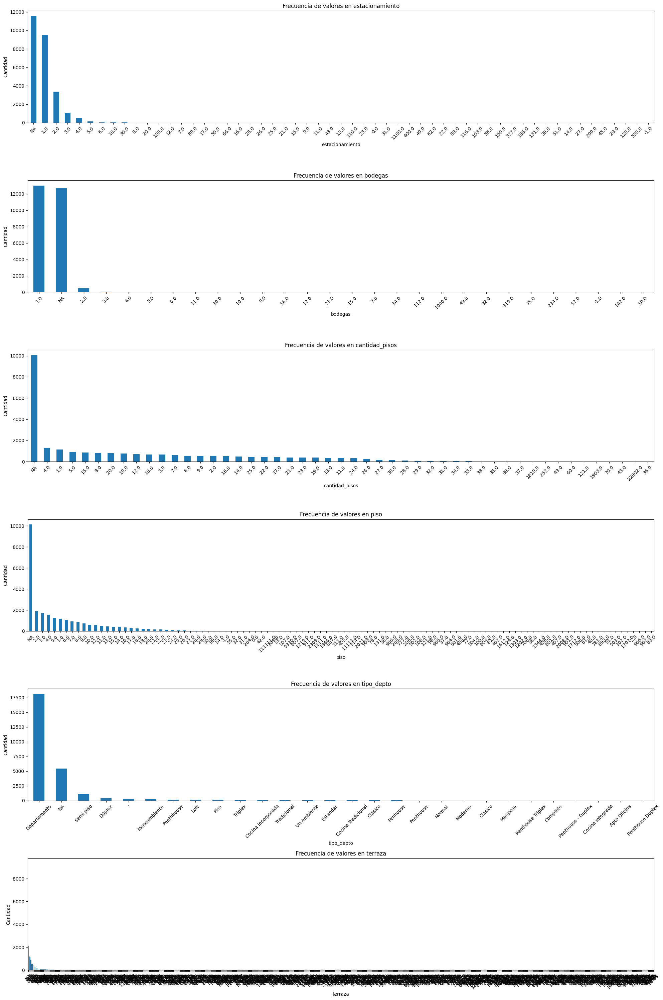

In [13]:
cols = ['estacionamiento', 'bodegas', 'cantidad_pisos', 
         'piso', 'tipo_depto', 'terraza']

plt.figure(figsize=(20, 30))

for i, col in enumerate(cols, 1):
    plt.subplot(len(cols), 1, i)
    
    # Convertir todos los valores a string, incluyendo pd.NA correctamente
    series_str = df[col].apply(lambda x: str(x) if pd.notna(x) else 'NA')
    value_counts = series_str.value_counts()
    
    value_counts.plot(kind='bar')
    plt.title(f'Frecuencia de valores en {col}')
    plt.xlabel(col)
    plt.ylabel('Cantidad')
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

In [31]:
df.to_csv('deptos_en_limpieza.csv', index=False)

In [8]:
# Conteo de valores no nulos
print("Frecuencia de los 10 valores más comunes (excluyendo NaNs):")
print(df['terraza'].value_counts().head(10))

print("\nCantidad de valores nulos en 'terraza':")
print(df['terraza'].isnull().sum())

# Contar la cantidad de ceros en la columna 'terraza'
ceros_en_terraza = (df['terraza'] == 0).sum()
print(f"Número de propiedades con terraza de 0 m²: {ceros_en_terraza}")

Frecuencia de los 10 valores más comunes (excluyendo NaNs):
terraza
2.00     2131
3.00     1873
4.00     1172
5.00     1117
10.00     879
6.00      864
20.00     553
1.00      539
8.00      527
7.00      413
Name: count, dtype: int64

Cantidad de valores nulos en 'terraza':
9318
Número de propiedades con terraza de 0 m²: 0


In [9]:
# Conteo de valores no nulos
print("Frecuencia de los 10 valores más comunes (excluyendo NaNs):")
print(df['estacionamiento'].value_counts().head(10))

print("\nCantidad de valores nulos en 'estacionamiento':")
print(df['estacionamiento'].isnull().sum())

# Contar la cantidad de ceros en la columna 'terraza'
ceros_en_estacionamiento = (df['estacionamiento'] == 0).sum()
print(f"Número de propiedades con estacionamiento de 0 m²: {ceros_en_estacionamiento}")

Frecuencia de los 10 valores más comunes (excluyendo NaNs):
estacionamiento
1.00     9497
2.00     3366
3.00     1078
4.00      549
5.00      121
6.00       39
10.00      10
30.00       9
8.00        7
20.00       6
Name: count, dtype: int64

Cantidad de valores nulos en 'estacionamiento':
11549
Número de propiedades con estacionamiento de 0 m²: 1


In [18]:
# Conteo de valores no nulos
print("Frecuencia de los 10 valores más comunes (excluyendo NaNs):")
print(df['bodegas'].value_counts().head(10))

print("\nCantidad de valores nulos en 'bodegas':")
print(df['bodegas'].isnull().sum())

# Contar la cantidad de ceros en la columna 'terraza'
ceros_en_bodegas = (df['bodegas'] == 0).sum()
print(f"Número de propiedades con bodegas de 0 m²: {ceros_en_bodegas}")

Frecuencia de los 10 valores más comunes (excluyendo NaNs):
bodegas
1.00     13014
2.00       483
3.00        48
4.00        12
5.00         6
6.00         3
11.00        2
30.00        2
10.00        2
0.00         1
Name: count, dtype: int64

Cantidad de valores nulos en 'bodegas':
12709
Número de propiedades con bodegas de 0 m²: 1


In [19]:
print("---")
print("Filas con 'estacionamiento' = 0:")
estacionamiento_cero_df = df[df['estacionamiento'] == 0]
if not estacionamiento_cero_df.empty:
    print(estacionamiento_cero_df)
else:
    print("No se encontraron filas con 'estacionamiento' igual a 0.")

print("\n---")
print("Filas con 'bodegas' = 0:")
bodegas_cero_df = df[df['bodegas'] == 0]
if not bodegas_cero_df.empty:
    print(bodegas_cero_df)
else:
    print("No se encontraron filas con 'bodegas' igual a 0.")
print("---")

---
Filas con 'estacionamiento' = 0:
               id  monto  ppm2  superficie_t  superficie_u  terraza  \
15894  1589933771     15  0.27         59.00         56.00     3.00   

       dormitorios  banos  estacionamiento  bodegas  cantidad_pisos  piso  \
15894         3.00   2.00             0.00     0.00            6.00  6.00   

         tipo_depto  antiguedad  latitud  longitud    comuna  \
15894  Departamento       22.00   -33.39    -70.68  Conchalí   

                       calle orientacion_norm  Or_N  Or_S  Or_E  Or_O  
15894  Avenida Independencia                S     0     1     0     0  

---
Filas con 'bodegas' = 0:
               id  monto  ppm2  superficie_t  superficie_u  terraza  \
15894  1589933771     15  0.27         59.00         56.00     3.00   

       dormitorios  banos  estacionamiento  bodegas  cantidad_pisos  piso  \
15894         3.00   2.00             0.00     0.00            6.00  6.00   

         tipo_depto  antiguedad  latitud  longitud    comuna  \


In [8]:
df.describe()

,id,monto,ppm2,superficie_t,superficie_u,terraza,dormitorios,banos,estacionamiento,bodegas,cantidad_pisos,piso,antiguedad,latitud,longitud,Or_N,Or_S,Or_E,Or_O
count,26299.00,26299.00,26294.00,26299.00,26066.00,16981.00,25597.00,23986.00,14750.00,13590.00,16239.00,16174.00,20586.00,26299.00,26299.00,26299.00,26299.00,26299.00,26299.00
mean,2246762710.85,7501.28,79.30,134.27,103.05,27.07,2.33,1.97,1.93,1.22,13.91,25.03,12.94,-33.44,-70.62,0.24,0.22,0.07,0.38
std,627748454.70,9055.07,427.72,1917.82,584.96,273.82,1.17,1.17,11.73,9.74,180.98,1240.34,14.09,0.04,0.05,0.43,0.41,0.26,0.48
min,1359204515.00,15.00,0.00,1.00,-0.01,0.50,1.00,1.00,-1.00,-1.00,1.00,-2.00,0.00,-33.65,-70.83,0.00,0.00,0.00,0.00
25%,1580479350.00,2330.50,53.00,44.00,41.00,3.00,1.00,1.00,1.00,1.00,5.00,3.00,3.00,-33.46,-70.65,0.00,0.00,0.00,0.00
50%,2751955500.00,3913.00,70.00,65.00,60.00,6.00,2.00,2.00,1.00,1.00,11.00,6.00,9.00,-33.44,-70.62,0.00,0.00,0.00,0.00
75%,2850891501.00,8600.00,92.00,115.00,100.00,20.00,3.00,2.00,2.00,1.00,19.00,11.00,17.00,-33.42,-70.58,0.00,0.00,0.00,1.00
max,2864912270.00,158000.00,65000.00,292675.00,66635.00,32543.00,37.00,43.00,1100.00,1040.00,22902.00,111111.00,209.00,-33.28,-70.49,1.00,1.00,1.00,1.00


In [10]:
df_dropna = df.dropna().copy()


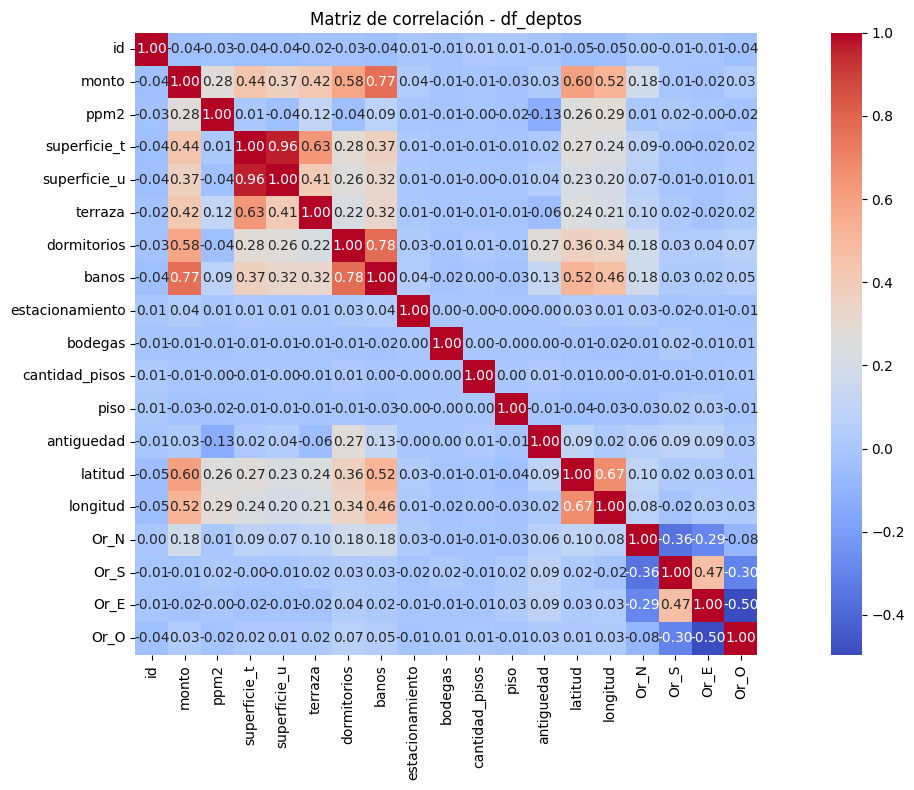

In [11]:
# Crear matriz de correlación
correlation_matrix = df_dropna.corr(numeric_only=True)

# Graficar la matriz de correlación
plt.figure(figsize=(15, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", square=True)
plt.title("Matriz de correlación - df_deptos")
plt.tight_layout()
plt.show()


En las variables numericas parece haber una fuerte relacion lineal entre el monto y banos, dormitorios, terraza, superficie_u y superficie_t, ademas de latitud y longitud. Por otro lado, una muy debil relacion con estacionamiento, bodegas, cantidad_pisos, piso y antiguedad. 
Mas adelante se evalua si en un modelo no lineal estas variables que parecen poco explicativas adquieren mayor valor.

In [25]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26299 entries, 0 to 26298
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                26299 non-null  int64  
 1   monto             26299 non-null  int64  
 2   ppm2              26294 non-null  float64
 3   superficie_t      26299 non-null  float64
 4   superficie_u      26066 non-null  float64
 5   terraza           16981 non-null  float64
 6   dormitorios       25597 non-null  float64
 7   banos             23986 non-null  float64
 8   estacionamiento   14750 non-null  float64
 9   bodegas           13590 non-null  float64
 10  cantidad_pisos    16239 non-null  float64
 11  piso              16174 non-null  float64
 12  tipo_depto        20883 non-null  object 
 13  antiguedad        20586 non-null  float64
 14  latitud           26299 non-null  float64
 15  longitud          26299 non-null  float64
 16  comuna            26299 non-null  object

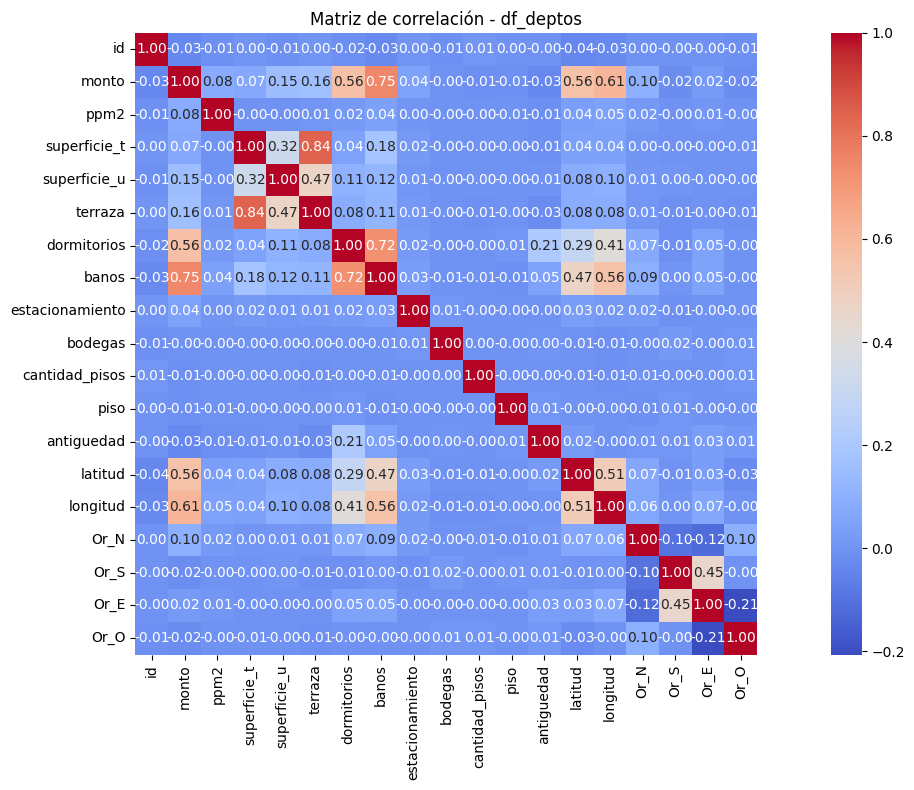

In [12]:
# Crear matriz de correlación
correlation_matrix = df.corr(numeric_only=True)

# Graficar la matriz de correlación
plt.figure(figsize=(15, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", square=True)
plt.title("Matriz de correlación - df_deptos")
plt.tight_layout()
plt.show()

Justificación Unificada para la Imputación de 'Terraza', 'Estacionamiento' y 'Bodegas' con 0
Dada la naturaleza de tu dataset, obtenido mediante web scraping con ingreso manual de información por parte de usuarios, se observa un patrón consistente en las columnas terraza, estacionamiento y bodegas. Para terraza, existe un alto volumen de valores nulos (NaN) y ningún valor explícito de 0. Para estacionamiento y bodegas, también hay un número significativo de NaNs, y la única instancia de un valor 0 explícito para ambas columnas corresponde a la misma propiedad, lo que sugiere un comportamiento de ingreso de datos anómalo o específico de un usuario. Estadísticamente, es altamente improbable que ninguna de las 26,000 propiedades carezca de terraza, estacionamiento o bodega. Por ello, la evidencia contextual y el conocimiento del dominio inmobiliario chileno (donde muchas propiedades, especialmente de ciertas tipologías o ubicaciones, carecen naturalmente de estas características) nos permiten concluir que la ausencia de un valor en estas columnas (NaN) representa la ausencia de la característica, es decir, un valor de 0 m² o 0 unidades. Imputar los valores nulos con 0 para estas tres columnas es la estrategia más lógica y estadísticamente válida, ya que traduce la ausencia implícita a un valor numérico explícito, permitiendo que tu modelo predictivo capture de manera precisa el impacto de la no existencia de estas características en el valor de la propiedad.

In [11]:
df_limpio = df.copy()
columnas_a_imputar = ['terraza', 'estacionamiento', 'bodegas']

# 3. Reemplazar los valores faltantes (NaN) por 0 en las columnas especificadas
for col in columnas_a_imputar:
    df_limpio[col] = df_limpio[col].fillna(0)

print("Cantidad de NaNs después de la imputación:")
print(df_limpio[columnas_a_imputar].isnull().sum())


Cantidad de NaNs después de la imputación:
terraza            0
estacionamiento    0
bodegas            0
dtype: int64


In [12]:
df_limpio.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26299 entries, 0 to 26298
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                26299 non-null  int64  
 1   monto             26299 non-null  int64  
 2   ppm2              26294 non-null  float64
 3   superficie_t      26299 non-null  float64
 4   superficie_u      26066 non-null  float64
 5   terraza           26299 non-null  float64
 6   dormitorios       25597 non-null  float64
 7   banos             23986 non-null  float64
 8   estacionamiento   26299 non-null  float64
 9   bodegas           26299 non-null  float64
 10  cantidad_pisos    16239 non-null  float64
 11  piso              16174 non-null  float64
 12  tipo_depto        20883 non-null  object 
 13  antiguedad        20586 non-null  float64
 14  latitud           26299 non-null  float64
 15  longitud          26299 non-null  float64
 16  comuna            26299 non-null  object

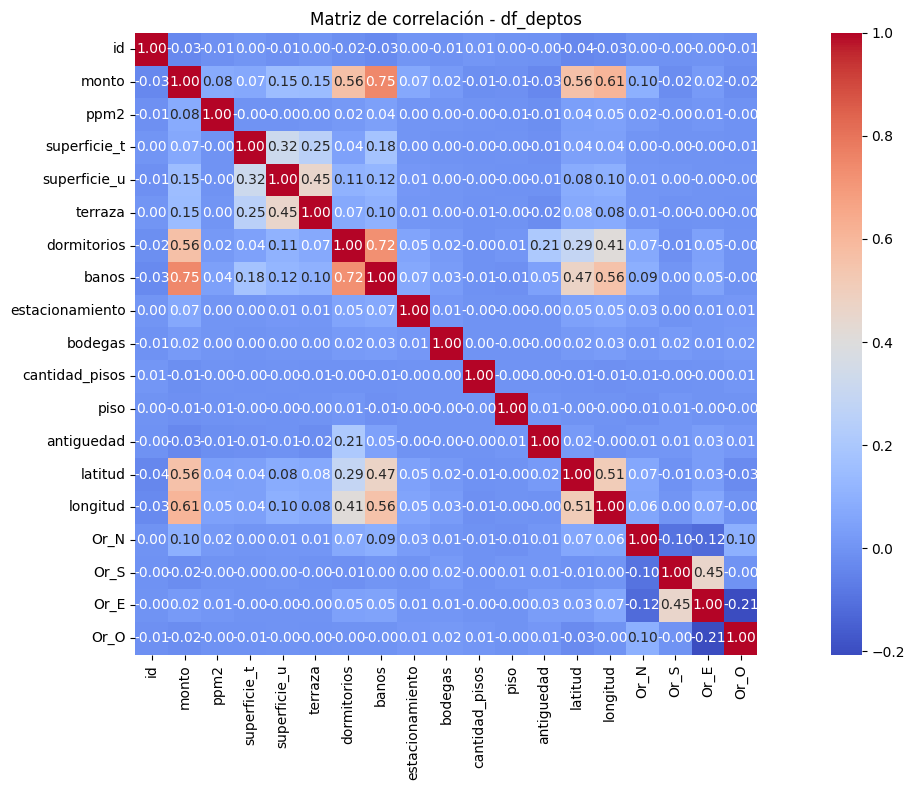

In [23]:
# Crear matriz de correlación
correlation_matrix = df_limpio.corr(numeric_only=True)

# Graficar la matriz de correlación
plt.figure(figsize=(15, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="coolwarm", square=True)
plt.title("Matriz de correlación - df_deptos")
plt.tight_layout()
plt.show()

In [13]:
df_limpio['estacionamiento'] = pd.to_numeric(df_limpio['estacionamiento'], errors='coerce')
df_limpio.loc[df_limpio['estacionamiento'] < 0, 'estacionamiento'] = np.nan
df_limpio['estacionamiento'] = df_limpio['estacionamiento'].astype('Int64')

df_limpio['bodegas'] = pd.to_numeric(df_limpio['bodegas'], errors='coerce')
df_limpio.loc[df_limpio['bodegas'] < 0, 'bodegas'] = np.nan
df_limpio['bodegas'] = df_limpio['bodegas'].astype('Int64')

df_limpio['terraza'] = pd.to_numeric(df_limpio['terraza'], errors='coerce')
df_limpio.loc[df_limpio['terraza'] < 0, 'terraza'] = np.nan


In [14]:
print("estacionamiento\n", df_limpio['estacionamiento'].unique())
print("bodegas\n", df_limpio['bodegas'].unique())
print("terraza\n", df_limpio['terraza'].unique())

estacionamiento
 <IntegerArray>
[   1,    2,    5,    3,    0,    4,   10,  100,   40,   30,    6,    8,    7,
   31,   22,  200,   48,   17,   50,  120,  530,   12,   11,    9,   13,  155,
   16,   15,   25,   26,   80,   29,   45,   28,   27,   14,   51,   39,  131,
  150,  327,   20,   56,   23,   21, 1100,  400,  110,   62,   66,   89,  116,
  103, <NA>]
Length: 54, dtype: Int64
bodegas
 <IntegerArray>
[   1,    0,    2,    6,    3,    5,   10,    4,  142,   30, <NA>,   57,   11,
  234, 1040,   75,  319,   32,   49,  112,   34,    7,   15,   12,   56,   23,
   50]
Length: 27, dtype: Int64
terraza
 [  7.5  158.   330.   ...   7.51 237.98   2.11]


In [31]:
umbral_estacionamiento = 10
conteo_estacionamiento_atipico = df_limpio[df_limpio['estacionamiento'] > umbral_estacionamiento].shape[0]

print(f"Número de propiedades con más de {umbral_estacionamiento} estacionamientos: {conteo_estacionamiento_atipico}")

# Contar valores atípicos en 'bodegas'
umbral_bodegas = 5
conteo_bodegas_atipico = df_limpio[df_limpio['bodegas'] > umbral_bodegas].shape[0]

print(f"Número de propiedades con más de {umbral_bodegas} bodegas: {conteo_bodegas_atipico}")

# Opcional: Ver algunos de los valores atípicos para confirmar
print("\nValores de 'estacionamiento' superiores a 10 (primeros 20):")
print(df_limpio[df_limpio['estacionamiento'] > umbral_estacionamiento]['estacionamiento'].value_counts().head(20))

print("\nValores de 'bodegas' superiores a 5 (primeros 20):")
print(df_limpio[df_limpio['bodegas'] > umbral_bodegas]['bodegas'].value_counts().head(20))

Número de propiedades con más de 10 estacionamientos: 76
Número de propiedades con más de 5 bodegas: 25

Valores de 'estacionamiento' superiores a 10 (primeros 20):
estacionamiento
30     9
20     6
100    4
12     4
17     3
50     3
80     3
11     2
25     2
15     2
16     2
21     2
26     2
28     2
48     2
66     2
23     1
327    1
56     1
400    1
Name: count, dtype: Int64

Valores de 'bodegas' superiores a 5 (primeros 20):
bodegas
6       3
30      2
11      2
10      2
112     1
23      1
56      1
12      1
15      1
7       1
34      1
32      1
49      1
319     1
75      1
1040    1
234     1
57      1
142     1
50      1
Name: count, dtype: Int64


In [20]:
df_missing_flags = df.copy()

# Creamos columnas booleanas para cada tipo de NaN
df_missing_flags['missing_terraza'] = df_missing_flags['terraza'].isna()
df_missing_flags['missing_estacionamiento'] = df_missing_flags['estacionamiento'].isna()
df_missing_flags['missing_bodegas'] = df_missing_flags['bodegas'].isna()

# Filtramos solo las filas que tienen al menos un NaN en estas 3 columnas
df_missing_locations = df_missing_flags[
    df_missing_flags['missing_terraza'] |
    df_missing_flags['missing_estacionamiento'] |
    df_missing_flags['missing_bodegas']
].copy() # Usar .copy() para evitar SettingWithCopyWarning

# Función para determinar el color basado en los NaNs
def get_color(row):
    r, g, b = 0, 0, 0 # Inicializar colores a negro (0,0,0)

    if row['missing_terraza']:
        r = 255
    if row['missing_estacionamiento']:
        g = 255
    if row['missing_bodegas']:
        b = 255

    # Para que el blanco no sea tan dominante si faltan los 3
    # Podemos reducir la intensidad para que se note la mezcla
    if r == 255 and g == 255 and b == 255:
        r, g, b = 200, 200, 200 # Un gris claro en lugar de blanco puro

    return f'#{r:02x}{g:02x}{b:02x}' # Convertir a formato hexadecimal

# Aplicar la función para obtener el color de cada punto
df_missing_locations['marker_color'] = df_missing_locations.apply(get_color, axis=1)

# --- Creación del mapa ---
# Define el centro inicial del mapa (puedes ajustarlo si los puntos faltantes están en otra zona)
# Usaremos un centro que abarque mejor las comunas de Santiago donde suele haber departamentos.
# Si tus datos tienen latitud/longitud fuera de Santiago, ajusta esto.
centro_mapa = [-33.45, -70.66] # Centro de Santiago

# Crear el mapa base
mapa_missing_data = folium.Map(location=centro_mapa, zoom_start=12)

# Añadir una leyenda para los colores (opcional, pero muy útil)
# Esta es una leyenda simple, para una interactiva se requiere más código
legend_html = '''
     <div style="position: fixed;
                 bottom: 50px; left: 50px; width: 200px; height: 160px;
                 border:2px solid grey; z-index:9999; font-size:14px;
                 background-color:white; opacity:0.9;">
       &nbsp;<b>Datos Faltantes</b><br>
       &nbsp;<i style="background:red; opacity:0.7;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Terraza<br>
       &nbsp;<i style="background:green; opacity:0.7;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Estacionamiento<br>
       &nbsp;<i style="background:blue; opacity:0.7;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Bodega<br>
       &nbsp;<i style="background:yellow; opacity:0.7;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Terraza & Estacionamiento<br>
       &nbsp;<i style="background:magenta; opacity:0.7;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Terraza & Bodega<br>
       &nbsp;<i style="background:cyan; opacity:0.7;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Estacionamiento & Bodega<br>
       &nbsp;<i style="background:#C8C8C8; opacity:0.7;">&nbsp;&nbsp;&nbsp;&nbsp;</i>&nbsp; Todos Faltantes<br>
     </div>
     '''
mapa_missing_data.get_root().html.add_child(folium.Element(legend_html))


# Iterar sobre las filas del DataFrame filtrado y agregar los marcadores
for idx, row in df_missing_locations.iterrows():
    # Asegurarse de que latitud y longitud no sean NaN para poder dibujar el punto
    if pd.notna(row['latitud']) and pd.notna(row['longitud']):
        folium.CircleMarker(
            location=[row['latitud'], row['longitud']],
            radius=4, # Aumentar un poco el radio para que se vea mejor el color
            color=row['marker_color'],
            fill=True,
            fill_color=row['marker_color'],
            fill_opacity=0.7,
            popup=f"ID: {row['id']}<br>"
                  f"Terraza Missing: {row['missing_terraza']}<br>"
                  f"Estacionamiento Missing: {row['missing_estacionamiento']}<br>"
                  f"Bodega Missing: {row['missing_bodegas']}"
        ).add_to(mapa_missing_data)

# Mostrar el mapa (en un entorno como Jupyter Notebook/Lab)
mapa_missing_data

MAE: 1164.43
R^2 Score: 0.9232


C:\Users\Pc-ADS\AppData\Local\Temp\ipykernel_28856\761713006.py:42: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=importances, y=importances.index, palette='viridis')


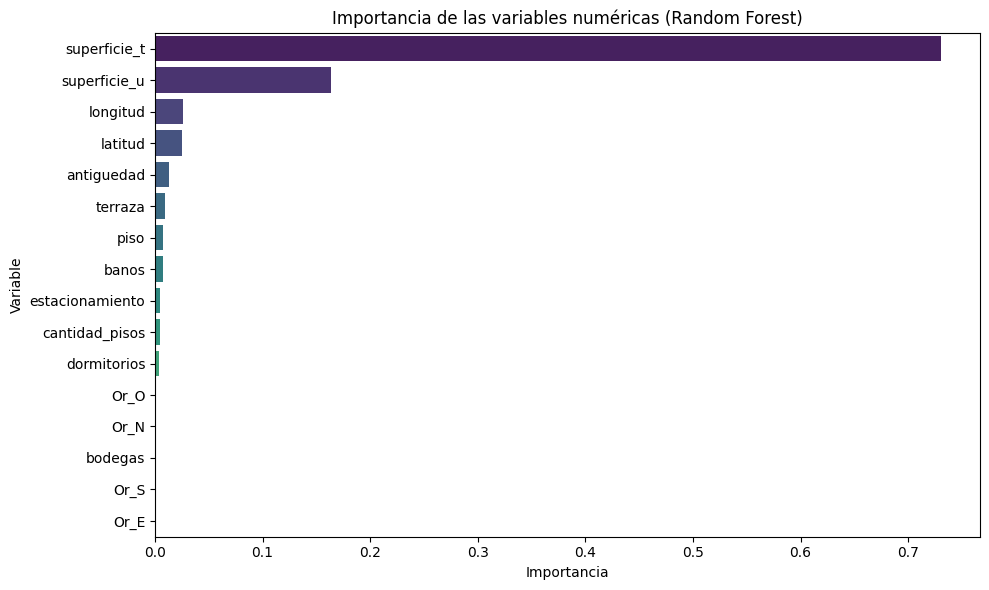

In [29]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, r2_score
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Variables numéricas seleccionadas
features = [
    'superficie_t', 'superficie_u', 'terraza', 'dormitorios', 'banos',
    'estacionamiento', 'bodegas', 'cantidad_pisos', 'piso',
    'antiguedad', 'latitud', 'longitud', 'Or_N', 'Or_S', 'Or_E', 'Or_O'
]

# 1. Features y target
X = df_dropna[features]
y = df_dropna['monto']

# 2. Split train/test
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# 3. Entrenar modelo
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# 4. Evaluación
y_pred = model.predict(X_test)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

print(f"MAE: {mae:.2f}")
print(f"R^2 Score: {r2:.4f}")

# 5. Importancia de variables
importances = pd.Series(model.feature_importances_, index=X.columns)
importances = importances.sort_values(ascending=False)

# Visualización
plt.figure(figsize=(10,6))
sns.barplot(x=importances, y=importances.index, palette='viridis')
plt.title("Importancia de las variables numéricas (Random Forest)")
plt.xlabel("Importancia")
plt.ylabel("Variable")
plt.tight_layout()
plt.show()


Notamos que en un random forest, las variables antiguedad, piso, cantidad_pisos, estacionamiento y bodegas siguen teniendo poco peso. Sin embargo notamos tambien que superficie_t tiene preponderancia casi absoluta comparada con las otras variables.
Mas adelente se realizara otro modelo random forest (para estudiar relaciones no lineales) sin las columnas de superficie.

R²: 0.8589869819279707
MAE: 1728.5510827625571


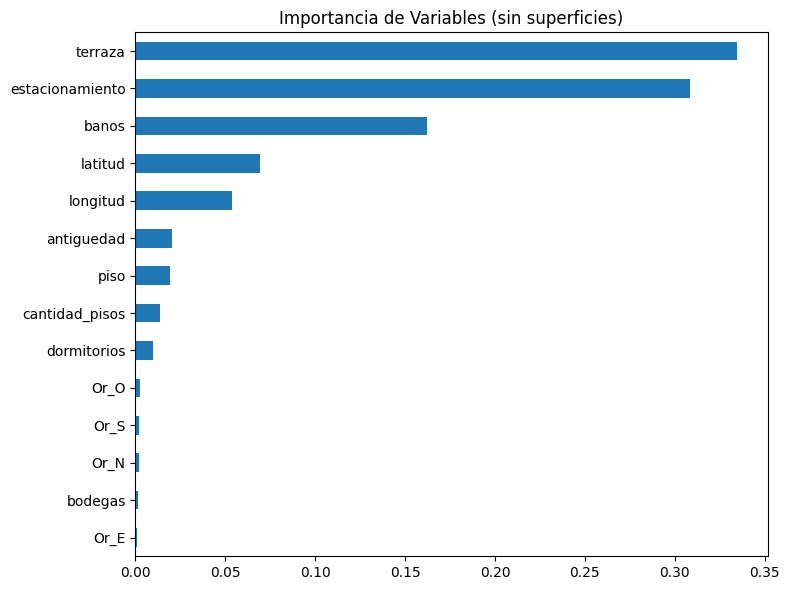

In [30]:
import pandas as pd
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_absolute_error
import matplotlib.pyplot as plt

# Definir variables a usar (excluyendo superficie_t y superficie_u)
features_sin_superficie = [
    'terraza', 'dormitorios', 'banos',
    'estacionamiento', 'bodegas', 'cantidad_pisos', 'piso',
    'antiguedad', 'latitud', 'longitud', 'Or_N', 'Or_S', 'Or_E', 'Or_O'
]

# Asegurarnos de que no haya strings extraños como '-' (por si acaso)
df_model = df_dropna.copy()
for col in features_sin_superficie:
    df_model = df_model[df_model[col].apply(lambda x: isinstance(x, (int, float)))]

# Definir variables predictoras y objetivo
X = df_model[features_sin_superficie]
y = df_model['monto']

# División en entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state=42)

# Entrenamiento del modelo
model = RandomForestRegressor(random_state=42)
model.fit(X_train, y_train)

# Predicciones
y_pred = model.predict(X_test)

# Métricas de evaluación
print("R²:", r2_score(y_test, y_pred))
print("MAE:", mean_absolute_error(y_test, y_pred))

# Importancia de las variables
importances = pd.Series(model.feature_importances_, index=features_sin_superficie)
importances.sort_values(ascending=True).plot(kind='barh', figsize=(8, 6), title="Importancia de Variables (sin superficies)")
plt.tight_layout()
plt.show()


Al eliminar las superficies, notamos que variables que tenian poca influencia adquieren mas importancia.

##### Analisis de columna orientacion.
 - Imputar datos nulos
 - Normalizar valores
 - Crear columnas Or_N, Or_S, Or_E, Or_O binarias. Mas de una columna puede tener valor 1.
Problema: Muchos datos nulos (9000/26600 aprox). 
Evaluar la posibilidad de predecir los valores de orientacion de acuerdo a otras variables

In [ ]:
df['orientacion'] = df['orientacion'].replace(['NA', '-', 'No ingresada'], np.nan)

# Diccionario de reemplazo
reemplazos = {
    'P': 'O', 'Poniente': 'O', 'PONIENTE': 'O',
    'Norte': 'N', 'NORTE': 'N',
    'Sur': 'S', 'SUR': 'S',
    'Oriente': 'E', 'ORIENTE': 'E',
    'SP': 'SO', 'Sur-Poniente': 'SO', 'Sur-poniente': 'SO', 'SURPONIENTE': 'SO',
    'NP': 'NO', 'Nor-Poniente': 'NO', 'NorPoniente': 'NO', 'Nor-poniente': 'NO', 'NORPONIENTE': 'NO',
    'SO': 'SE', 'Sur-Oriente': 'SE', 'Sur / Oriente': 'SE', 'SURORIENTE': 'SE',
    'Nor-Oriente': 'NE', 'Nor / Oriente': 'NE', 'Nor-oriente': 'NE', 'Nor-Orienteff': 'NE', 'NORORIENTE': 'NE',
    'NorOriente-Sur': 'NSE',
    'NorOriente-Poniente': 'NEO',
    'Oriente-SurPoniente': 'SEO',
    'Nor / Oriente / Poniente': 'NEO',
    'Oriente-Poniente': 'EO', 'Oriente-poniente': 'EO',
    'Norte-sur-poniente': 'NSO',
    'Nor / Poniente / Sur': 'NSO',
    'ORI-NOR-PON-SUR': 'NSOE',
    'Todas': 'NSOE',
    'Nor / Poniente': 'NO',
    'Nor / Oriente / Poniente': 'NEO',
    'Norte-Sur': 'NS', 'Norte-sur': 'NS',
    'NorPoniente-Sur': 'NSO',  
    'Norte-oriente-poniente': 'NEO', 
    'Sur-oriente': 'SE',
    'ORI-NOR-PON': 'NEO' 
}

# Aplicar reemplazos
df['orientacion_norm'] = df['orientacion'].replace(reemplazos)


In [19]:
for letra in 'NSEO':
    df[f'Or_{letra}'] = df['orientacion_norm'].apply(lambda x: int(letra in x) if pd.notna(x) else 0)


In [21]:
df.sample(10)

,id,monto,ppm2,superficie_t,superficie_u,terraza,dormitorios,banos,estacionamiento,bodegas,cantidad_pisos,piso,tipo_depto,orientacion,antiguedad,latitud,longitud,comuna,calle,orientacion_norm,Or_N,Or_S,Or_E,Or_O
3424,2833670022,1409,25.00,55.00,55.00,NaN,3.00,1.00,NaN,NaN,NaN,NaN,NaN,NaN,55.00,-33.55,-70.63,La Granja,Las Uvas Y El Viento,NaN,0,0,0,0
12738,2863977846,1780,57.00,32.00,31.00,NaN,1.00,1.00,NaN,NaN,30.00,5.00,Departamento,N,8.00,-33.44,-70.66,Santiago,Rosas,N,1,0,0,0
14931,2767033722,3990,56.00,71.00,71.00,2.00,3.00,2.00,2.00,1.00,17.00,7.00,Departamento,SP,11.00,-33.49,-70.62,Macul,Avenida Escuela Agrícola,SO,0,1,0,1
12670,2854204354,1824,50.00,39.00,36.00,3.00,1.00,1.00,1.00,1.00,31.00,NaN,Departamento,SP,0.00,-33.43,-70.66,Santiago,Avenida Mapocho,SO,0,1,0,1
865,2838249250,37000,92.00,500.00,400.00,100.00,6.00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-33.34,-70.54,Lo Barnechea,Parque Golf,NaN,0,0,0,0
22537,1564032003,5500,84.00,68.00,65.00,3.00,2.00,2.00,1.00,1.00,NaN,13.00,Departamento,SO,NaN,-33.44,-70.60,Providencia,Avenida Suecia,SE,0,1,1,0
6952,2812264926,20000,64.00,310.00,310.00,80.00,4.00,4.00,3.00,1.00,10.00,NaN,Penthhouse,NOSP,NaN,-33.43,-70.56,Las Condes,Avenida Manquehue Sur,NOSP,1,1,0,1
2117,2859126280,2562,49.00,58.00,52.00,6.00,2.00,2.00,NaN,1.00,16.00,9.00,Departamento,NaN,7.00,-33.50,-70.65,San Miguel,Pirámide,NaN,0,0,0,0
18067,1567161019,12800,87.00,167.00,147.00,20.00,3.00,3.00,2.00,1.00,NaN,NaN,Departamento,NaN,5.00,-33.40,-70.58,Vitacura,Luis Carrera,NaN,0,0,0,0
7747,2798948294,16210,119.00,230.00,136.00,NaN,4.00,4.00,1.00,1.00,2.00,1.00,Departamento,SP,1.00,-33.42,-70.51,Las Condes,Avenida Francisco Bulnes Correa,SO,0,1,0,1


In [24]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26299 entries, 0 to 26298
Data columns (total 23 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   id                26299 non-null  int64  
 1   monto             26299 non-null  int64  
 2   ppm2              26294 non-null  float64
 3   superficie_t      26299 non-null  float64
 4   superficie_u      26066 non-null  float64
 5   terraza           16981 non-null  float64
 6   dormitorios       25597 non-null  float64
 7   banos             23986 non-null  float64
 8   estacionamiento   14750 non-null  float64
 9   bodegas           13590 non-null  float64
 10  cantidad_pisos    16239 non-null  float64
 11  piso              16174 non-null  float64
 12  tipo_depto        20883 non-null  object 
 13  antiguedad        20586 non-null  float64
 14  latitud           26299 non-null  float64
 15  longitud          26299 non-null  float64
 16  comuna            26299 non-null  object